<a href="https://colab.research.google.com/github/BryeWhite/final-year-projects/blob/main/Copy_of_Untitled5.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Mounting of drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Import your liberies

In [ ]:
import warnings
warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, OneHotEncoder, LabelEncoder
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import TruncatedSVD
from sklearn.impute import SimpleImputer
from sklearn.pipeline import Pipeline


# libraries for models
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier, BaggingClassifier, GradientBoostingClassifier, RandomForestClassifier

# metrics evaluation libraries
from sklearn.metrics import auc, classification_report, confusion_matrix, roc_curve, RocCurveDisplay

Read your data

In [ ]:
df = pd.read_excel("/content/drive/MyDrive/EricData.xlsx")
df = df.drop(columns=["id"]) # droping unwanted columns

KeyError: "['id'] not found in axis"

Defining your heading of your data

In [ ]:
df.head()

,Gender,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,F,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,F,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,M,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,F,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,F,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29


defining the tail of your data

In [ ]:
df.tail()

,Gender,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
1015,F,27,4,2,1,12,13,18,23,28,21,21,3,3,3,3,30
1016,F,37,5,2,7,12,15,18,24,28,3,3,3,3,3,3,30
1017,M,54,6,1,7,11,16,17,24,28,3,3,3,3,3,3,29
1018,F,21,6,2,3,9,15,19,24,26,3,3,21,21,21,21,31
1019,F,37,6,3,7,9,13,19,22,27,3,3,3,21,21,21,31


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 17 columns):
 #   Column                                          Non-Null Count  Dtype 
---  ------                                          --------------  ----- 
 0   Gender                                          1016 non-null   object
 1   Age                                             1020 non-null   int64 
 2   Level_of_education                              1020 non-null   int64 
 3   Income_level                                    1020 non-null   int64 
 4   Level_of_trust                                  1020 non-null   int64 
 5   Influencing_factors                             1020 non-null   int64 
 6   Importance_of_Transparency_and_Explainability   1020 non-null   int64 
 7   Understanding_AI_by_users                       1020 non-null   int64 
 8   Transparency_Measures_and_Explanations          1020 non-null   int64 
 9   Percieved_Reliability_and_Accuracy              1020

Seeking information about the data

In [ ]:
df.describe()

,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
count,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000,1020.000000
mean,36.345098,4.847059,2.223529,3.925490,10.301961,14.117647,17.952941,23.415686,26.827451,11.470588,8.082353,8.647059,9.141176,9.282353,9.282353,30.152941
std,15.736749,0.804880,0.773097,2.414858,1.181720,1.107510,0.977540,1.252965,0.704417,8.988823,8.106570,8.356210,8.538068,8.584092,8.584092,1.016132
min,18.000000,4.000000,1.000000,1.000000,9.000000,13.000000,17.000000,22.000000,26.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,29.000000
25%,22.000000,4.000000,2.000000,3.000000,9.000000,13.000000,17.000000,22.000000,26.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,29.000000
50%,32.000000,5.000000,2.000000,3.000000,10.000000,14.000000,18.000000,24.000000,27.000000,3.000000,3.000000,3.000000,3.000000,3.000000,3.000000,30.000000
75%,47.000000,6.000000,3.000000,7.000000,11.000000,15.000000,19.000000,25.000000,27.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,31.000000
max,77.000000,6.000000,3.000000,8.000000,12.000000,16.000000,20.000000,25.000000,28.000000,21.000000,21.000000,21.000000,21.000000,21.000000,21.000000,32.000000


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 17 columns):
 #   Column                                          Non-Null Count  Dtype 
---  ------                                          --------------  ----- 
 0   Gender                                          1016 non-null   object
 1   Age                                             1020 non-null   int64 
 2   Level_of_education                              1020 non-null   int64 
 3   Income_level                                    1020 non-null   int64 
 4   Level_of_trust                                  1020 non-null   int64 
 5   Influencing_factors                             1020 non-null   int64 
 6   Importance_of_Transparency_and_Explainability   1020 non-null   int64 
 7   Understanding_AI_by_users                       1020 non-null   int64 
 8   Transparency_Measures_and_Explanations          1020 non-null   int64 
 9   Percieved_Reliability_and_Accuracy              1020

In [ ]:
df.isna().sum()

,0
Gender,4
Age,0
Level_of_education,0
Income_level,0
Level_of_trust,0
Influencing_factors,0
Importance_of_Transparency_and_Explainability,0
Understanding_AI_by_users,0
Transparency_Measures_and_Explanations,0
Percieved_Reliability_and_Accuracy,0


Level_of_education
4    420
5    336
6    264
Name: count, dtype: int64


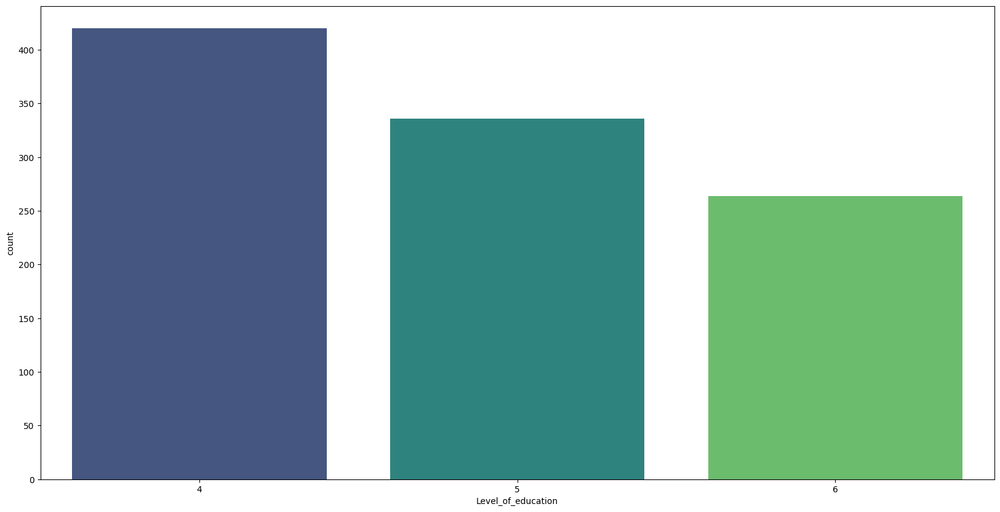

In [ ]:
plt.figure(figsize=(20, 10))
sns.countplot(x=df["Level_of_education"], palette='viridis')

# Print the value counts
print(df["Level_of_education"].value_counts())

# Show the plot
plt.show()

Converting from int to float

In [ ]:
df['Age'] = df['Age'].astype('float')

In [ ]:
df['Level_of_education'] = df['Level_of_education'].astype('float')

In [ ]:
df['Income_level'] = df['Income_level'].astype('float')

In [ ]:
df['Level_of_trust'] = df['Level_of_trust'].astype('float')

In [ ]:
df['Influencing_factors'] = df['Influencing_factors'].astype('float')

In [ ]:
df['Importance_of_Transparency_and_Explainability '] = df['Importance_of_Transparency_and_Explainability '].astype('float')

In [ ]:
df['Understanding_AI_by_users'] = df['Understanding_AI_by_users'].astype('float')

In [ ]:
df['Transparency_Measures_and_Explanations '] = df['Transparency_Measures_and_Explanations '].astype('float')

In [ ]:
df['Percieved_Reliability_and_Accuracy'] = df['Percieved_Reliability_and_Accuracy'].astype('float')

In [ ]:
df['Transparency_of_AI_Algorithms'] = df['Transparency_of_AI_Algorithms'].astype('float')

In [ ]:
df['Clarity_of_Instructions_of_AI'] = df['Clarity_of_Instructions_of_AI'].astype('float')

In [ ]:
df['Data_Privacy_and_Security_Measures'] = df['Data_Privacy_and_Security_Measures'].astype('float')

In [ ]:
df['Personalization_and_Customization_Options'] = df['Personalization_and_Customization_Options'].astype('float')

In [ ]:
df['Integration_with_Existing_Banking_Systems'] = df['Integration_with_Existing_Banking_Systems'].astype('float')

In [ ]:
df['User_Education_and_Onboarding'] = df['User_Education_and_Onboarding'].astype('float')

In [ ]:
df['Concerns_Regarding_Data_Privacy_and_Security'] = df['Concerns_Regarding_Data_Privacy_and_Security'].astype('float')

In [ ]:
df.columns.to_list()

['Gender',
 'Age',
 'Level_of_education',
 'Income_level',
 'Level_of_trust',
 'Influencing_factors',
 'Importance_of_Transparency_and_Explainability ',
 'Understanding_AI_by_users',
 'Transparency_Measures_and_Explanations ',
 'Percieved_Reliability_and_Accuracy',
 'Transparency_of_AI_Algorithms',
 'Clarity_of_Instructions_of_AI',
 'Data_Privacy_and_Security_Measures',
 'Personalization_and_Customization_Options',
 'Integration_with_Existing_Banking_Systems',
 'User_Education_and_Onboarding',
 'Concerns_Regarding_Data_Privacy_and_Security']

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 17 columns):
 #   Column                                          Non-Null Count  Dtype 
---  ------                                          --------------  ----- 
 0   Gender                                          1016 non-null   object
 1   Age                                             1020 non-null   int64 
 2   Level_of_education                              1020 non-null   int64 
 3   Income_level                                    1020 non-null   int64 
 4   Level_of_trust                                  1020 non-null   int64 
 5   Influencing_factors                             1020 non-null   int64 
 6   Importance_of_Transparency_and_Explainability   1020 non-null   int64 
 7   Understanding_AI_by_users                       1020 non-null   int64 
 8   Transparency_Measures_and_Explanations          1020 non-null   int64 
 9   Percieved_Reliability_and_Accuracy              1020

In [ ]:
df.head()

,Gender,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,F,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,F,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,M,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,F,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,F,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29


In [ ]:
numeric_columns = [column for column in df.columns if df[column].dtype == 'float64']
print(numeric_columns)

[]


In [ ]:
for column in numeric_columns:
    plt.figure(figsize=(12,8))
    sns.kdeplot(data=df, x=column, hue='Age', palette="crest", fill=True)
    plt.show()

In [ ]:
for column in numeric_columns:
    plt.figure(figsize=(12,8))
    sns.kdeplot(data=df, x=column, hue='Gender', palette="crest", fill=True)

In [ ]:
for column in numeric_columns:
    plt.figure(figsize=(12,8))
    sns.kdeplot(data=df, x=column, hue='Level_of_trust', palette="crest", fill=True)

In [ ]:
for column in numeric_columns:
    plt.figure(figsize=(12,8))
    sns.kdeplot(data=df, x=column, hue='Concerns_Regarding_Data_Privacy_and_Security', palette="crest", fill=True)
    plt.show()

In [ ]:
plt.figure(figsize=(20,10))
corr = df.corr()
sns.heatmap(corr, annot=True, cmap="YlGnBu")

ValueError: could not convert string to float: 'F'

<Figure size 2000x1000 with 0 Axes>

<Axes: >

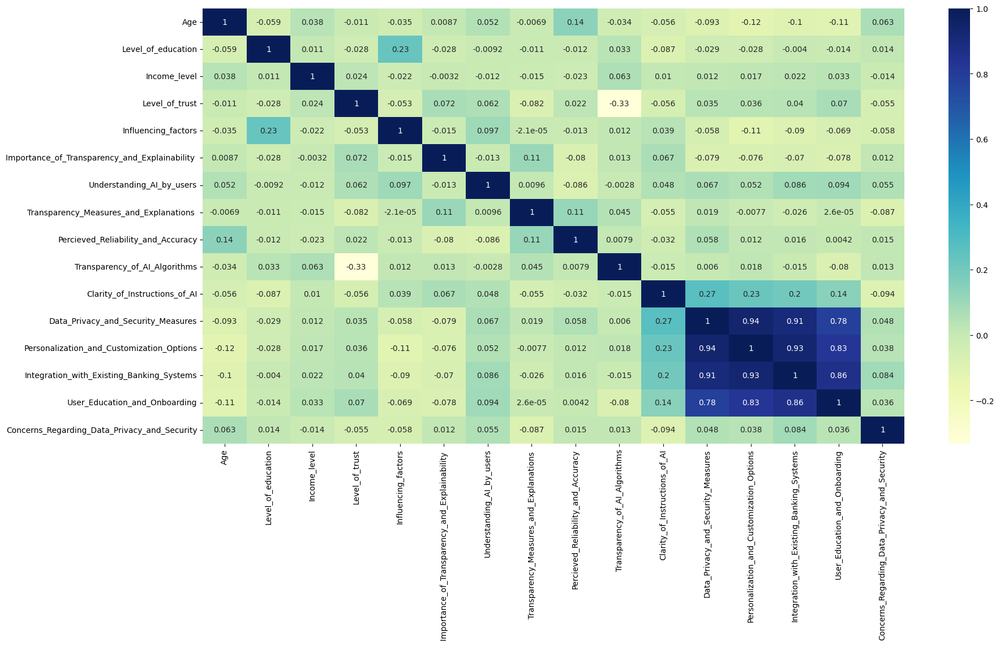

In [ ]:
plt.figure(figsize=(20,10))
corr = df2.corr()
sns.heatmap(corr, annot=True, cmap="YlGnBu")

In [ ]:
df2=df.copy()

In [ ]:
df2.head()

,Gender,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,F,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,F,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,M,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,F,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,F,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29


In [ ]:
df2.drop(columns=['Gender'], inplace=True)

In [ ]:
df2.head()

,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29


In [ ]:
df.head()

,Gender,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,F,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,F,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,M,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,F,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,F,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29


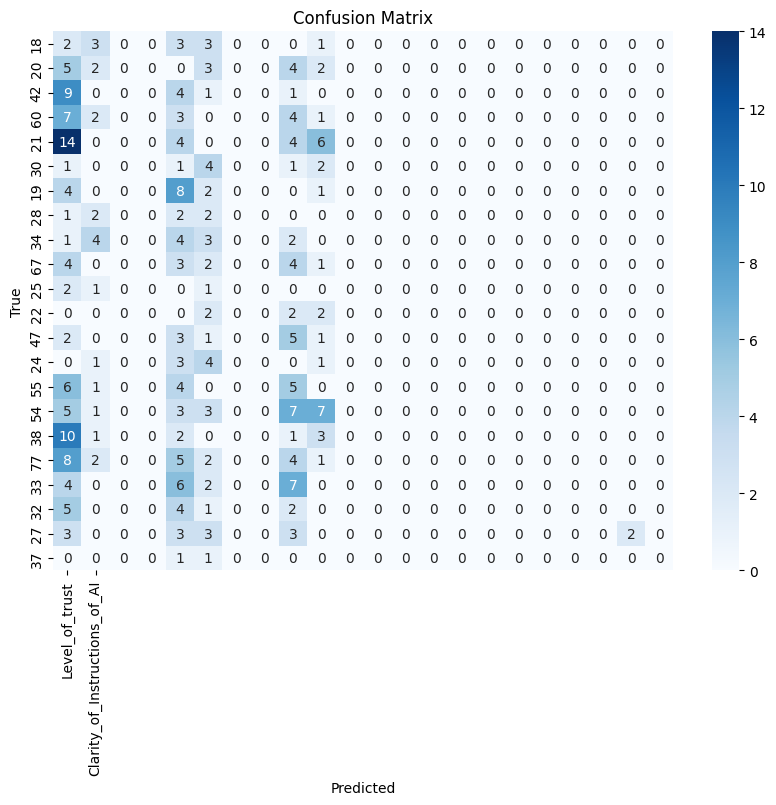

In [ ]:
!pip install scikit-learn
# Import necessary libraries
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.datasets import load_iris
from sklearn.ensemble import RandomForestClassifier

# Load dataset (using Iris dataset as an example)
data = df2_n
X = data.drop('Age', axis=1)
y = data['Age']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train a classifier (using RandomForest as an example)
clf = RandomForestClassifier()
clf.fit(X_train, y_train)

# Make predictions
y_pred = clf.predict(X_test)

# Generate the confusion matrix
cm = confusion_matrix(y_test, y_pred, labels=clf.classes_)

# Display the confusion matrix using seaborn heatmap
# Display the confusion matrix using seaborn heatmap
plt.figure(figsize=(10, 7))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=data.drop('Age',axis=1).columns, yticklabels=data['Age'].unique()) # Use .columns to get column names for x-axis and .unique() to get unique age values for y-axis
plt.xlabel('Predicted')
plt.ylabel('True')
plt.title('Confusion Matrix')
plt.show()


#Decision Tree

IndexError: index 20 is out of bounds for axis 0 with size 18

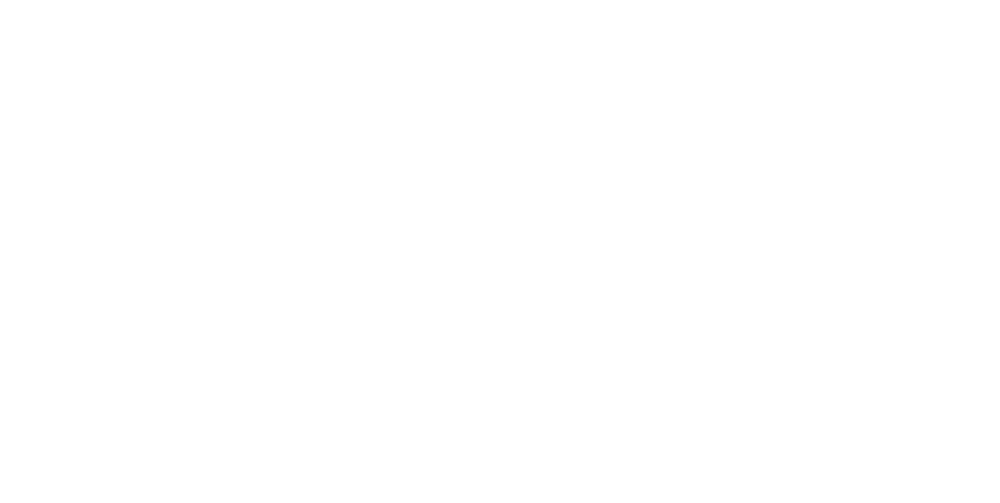

In [ ]:
# Import necessary libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.datasets import load_iris
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree

# Load the bank dataset
data = df2_n
X = data.drop('Age', axis=1)
y = data['Age']


# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Train a DecisionTreeClassifier
clf = DecisionTreeClassifier()
clf.fit(X_train, y_train)

# Make predictions
y_pred = clf.predict(X_test)

# Visualize the decision tree
plt.figure(figsize=(20,10))
plot_tree(clf, filled=True, feature_names=data.columns, class_names=data.columns)
plt.show()

# Optional: Print out the decision tree in text format
from sklearn.tree import export_text
tree_rules = export_text(clf, feature_names=data.columns)
print(tree_rules)


In [ ]:
#FIUT = df.read_excel('/content/drive')

In [ ]:
df2

,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,27,4,2,1,12,13,18,23,28,21,21,3,3,3,3,30
1016,37,5,2,7,12,15,18,24,28,3,3,3,3,3,3,30
1017,54,6,1,7,11,16,17,24,28,3,3,3,3,3,3,29
1018,21,6,2,3,9,15,19,24,26,3,3,21,21,21,21,31


In [ ]:
df.head()

,Gender,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,F,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,F,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,M,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,F,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,F,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29


In [ ]:
df2.head()

,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29


#Convert Gender to Integer

In [ ]:
df3=df.copy()

In [ ]:
from sklearn.preprocessing import LabelEncoder
le_gender = LabelEncoder()
# le_job = LabelEncoder()
# le_degree = LabelEncoder()

In [ ]:
df3['Gender_n'] = le_gender.fit_transform(df3['Gender'])
# df2['Job_n'] = le_job.fit_transform(inputs['Job'])
# df2['Degree_n'] = le_degree.fit_transform(inputs['Degree

In [ ]:
df2

,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security
0,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29
1,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29
2,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30
3,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29
4,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,27,4,2,1,12,13,18,23,28,21,21,3,3,3,3,30
1016,37,5,2,7,12,15,18,24,28,3,3,3,3,3,3,30
1017,54,6,1,7,11,16,17,24,28,3,3,3,3,3,3,29
1018,21,6,2,3,9,15,19,24,26,3,3,21,21,21,21,31


In [ ]:
#df2.column()

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 17 columns):
 #   Column                                          Non-Null Count  Dtype 
---  ------                                          --------------  ----- 
 0   Gender                                          1016 non-null   object
 1   Age                                             1020 non-null   int64 
 2   Level_of_education                              1020 non-null   int64 
 3   Income_level                                    1020 non-null   int64 
 4   Level_of_trust                                  1020 non-null   int64 
 5   Influencing_factors                             1020 non-null   int64 
 6   Importance_of_Transparency_and_Explainability   1020 non-null   int64 
 7   Understanding_AI_by_users                       1020 non-null   int64 
 8   Transparency_Measures_and_Explanations          1020 non-null   int64 
 9   Percieved_Reliability_and_Accuracy              1020

In [ ]:
from sklearn.preprocessing import LabelEncoder
le_gender = LabelEncoder()
le_Level_of_edication = LabelEncoder()
le_Income_level = LabelEncoder()
le_Level_of_trust = LabelEncoder()
le_Influencing_factors = LabelEncoder()
le_Importance_of_Transparency_and_Explainability = LabelEncoder()
le_Understanding_AI_by_users = LabelEncoder()
le_Transparency_Measures_and_Explanations = LabelEncoder()
le_Percieved_Reliability_and_Accuracy = LabelEncoder()
le_Transparency_of_AI_Algorithms = LabelEncoder()
le_Clarity_of_Instructions_of_AI = LabelEncoder()
le_Data_Privacy_and_Security_Measures = LabelEncoder()
le_Personalization_and_Customization_Options = LabelEncoder()
le_Integration_with_Existing_Banking_Systems = LabelEncoder()
le_User_Education_and_Onboarding = LabelEncoder()
le_Concerns_Regarding_Data_Privacy_and_Security = LabelEncoder()


In [ ]:
#df2['Gender_n'] = le_gender.fit_transform(df2['Gender'])
df2['Level_of_educati0n_n']=le_Level_of_edication.fit_transform(df2['Level_of_education'])
df2['Income_level_n']=le_Income_level.fit_transform(df2['Income_level'])
df2['Level_of_trust_n']=le_Level_of_trust.fit_transform(df2['Level_of_trust'])
df2['Influencing_factors_n']=le_Influencing_factors.fit_transform(df2['Influencing_factors'])
df2['Importance_of_Transparency_and_Explainability_n']=le_Importance_of_Transparency_and_Explainability.fit_transform(df2['Importance_of_Transparency_and_Explainability ']) #********
df2['Understanding_AI_by_users_n']=le_Understanding_AI_by_users.fit_transform(df2['Understanding_AI_by_users'])
df2['Transparency_Measures_and_Explanations_n']=le_Transparency_Measures_and_Explanations.fit_transform(df2['Transparency_Measures_and_Explanations ']) #**************
df2['Percieved_Reliability_and_Accuracy_n']=le_Percieved_Reliability_and_Accuracy.fit_transform(df2['Percieved_Reliability_and_Accuracy'])
df2['Transparency_of_AI_Algorithms_n']=le_Transparency_of_AI_Algorithms.fit_transform(df2['Transparency_of_AI_Algorithms']) # ******
df2['Clarity_of_Instructions_of_AI_n']=le_Clarity_of_Instructions_of_AI.fit_transform(df2['Clarity_of_Instructions_of_AI'])
df2['Data_Privacy_and_Security_Measures_n']=le_Data_Privacy_and_Security_Measures.fit_transform(df2['Data_Privacy_and_Security_Measures'])
df2['Personalization_and_Customization_Options_n']=le_Personalization_and_Customization_Options.fit_transform(df2['Personalization_and_Customization_Options'])
df2['Integration_with_Existing_Banking_Systems_n']=le_Integration_with_Existing_Banking_Systems.fit_transform(df2['Integration_with_Existing_Banking_Systems'])
df2['User_Education_and_Onboarding_n']=le_User_Education_and_Onboarding.fit_transform(df2['User_Education_and_Onboarding'])
df2['Concerns_Regarding_Data_Privacy_and_Security_n']=le_Concerns_Regarding_Data_Privacy_and_Security.fit_transform(df2['Concerns_Regarding_Data_Privacy_and_Security'])
df2

,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,...,Understanding_AI_by_users_n,Transparency_Measures_and_Explanations_n,Percieved_Reliability_and_Accuracy_n,Transparency_of_AI_Algorithms_n,Clarity_of_Instructions_of_AI_n,Data_Privacy_and_Security_Measures_n,Personalization_and_Customization_Options_n,Integration_with_Existing_Banking_Systems_n,User_Education_and_Onboarding_n,Concerns_Regarding_Data_Privacy_and_Security_n
0,18,4,1,3,9,13,17,22,26,3,...,0,0,0,0,0,0,0,1,0,0
1,20,5,1,3,9,13,17,23,26,21,...,0,1,0,1,0,0,1,0,0,0
2,42,5,3,7,10,14,17,22,27,21,...,0,0,1,1,1,1,1,1,0,1
3,60,5,1,7,10,13,18,23,27,3,...,1,1,1,0,0,0,0,0,0,0
4,21,4,2,8,9,15,17,24,27,3,...,0,2,1,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,27,4,2,1,12,13,18,23,28,21,...,1,1,2,1,1,0,0,0,0,1
1016,37,5,2,7,12,15,18,24,28,3,...,1,2,2,0,0,0,0,0,0,1
1017,54,6,1,7,11,16,17,24,28,3,...,0,2,2,0,0,0,0,0,0,0
1018,21,6,2,3,9,15,19,24,26,3,...,2,2,0,0,0,1,1,1,1,2


In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 31 columns):
 #   Column                                           Non-Null Count  Dtype
---  ------                                           --------------  -----
 0   Age                                              1020 non-null   int64
 1   Level_of_education                               1020 non-null   int64
 2   Income_level                                     1020 non-null   int64
 3   Level_of_trust                                   1020 non-null   int64
 4   Influencing_factors                              1020 non-null   int64
 5   Importance_of_Transparency_and_Explainability    1020 non-null   int64
 6   Understanding_AI_by_users                        1020 non-null   int64
 7   Transparency_Measures_and_Explanations           1020 non-null   int64
 8   Percieved_Reliability_and_Accuracy               1020 non-null   int64
 9   Transparency_of_AI_Algorithms                    102

In [ ]:
df2copy=df2.copy()

In [ ]:
df2copy

,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,...,Understanding_AI_by_users_n,Transparency_Measures_and_Explanations_n,Percieved_Reliability_and_Accuracy_n,Transparency_of_AI_Algorithms_n,Clarity_of_Instructions_of_AI_n,Data_Privacy_and_Security_Measures_n,Personalization_and_Customization_Options_n,Integration_with_Existing_Banking_Systems_n,User_Education_and_Onboarding_n,Concerns_Regarding_Data_Privacy_and_Security_n
0,18,4,1,3,9,13,17,22,26,3,...,0,0,0,0,0,0,0,1,0,0
1,20,5,1,3,9,13,17,23,26,21,...,0,1,0,1,0,0,1,0,0,0
2,42,5,3,7,10,14,17,22,27,21,...,0,0,1,1,1,1,1,1,0,1
3,60,5,1,7,10,13,18,23,27,3,...,1,1,1,0,0,0,0,0,0,0
4,21,4,2,8,9,15,17,24,27,3,...,0,2,1,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,27,4,2,1,12,13,18,23,28,21,...,1,1,2,1,1,0,0,0,0,1
1016,37,5,2,7,12,15,18,24,28,3,...,1,2,2,0,0,0,0,0,0,1
1017,54,6,1,7,11,16,17,24,28,3,...,0,2,2,0,0,0,0,0,0,0
1018,21,6,2,3,9,15,19,24,26,3,...,2,2,0,0,0,1,1,1,1,2


In [ ]:
df2_n = df2copy.drop(['Age', 'Level_of_education', 'Income_level', 'Influencing_factors', 'Importance_of_Transparency_and_Explainability ','Understanding_AI_by_users', 'Transparency_Measures_and_Explanations ', 'Percieved_Reliability_and_Accuracy', 'Transparency_of_AI_Algorithms', 'Data_Privacy_and_Security_Measures', 'Personalization_and_Customization_Options', 'Integration_with_Existing_Banking_Systems', 'User_Education_and_Onboarding', 'Concerns_Regarding_Data_Privacy_and_Security'],axis='columns')


In [ ]:
df2_n

,Level_of_trust,Clarity_of_Instructions_of_AI,Level_of_educati0n_n,Income_level_n,Level_of_trust_n,Influencing_factors_n,Importance_of_Transparency_and_Explainability_n,Understanding_AI_by_users_n,Transparency_Measures_and_Explanations_n,Percieved_Reliability_and_Accuracy_n,Transparency_of_AI_Algorithms_n,Clarity_of_Instructions_of_AI_n,Data_Privacy_and_Security_Measures_n,Personalization_and_Customization_Options_n,Integration_with_Existing_Banking_Systems_n,User_Education_and_Onboarding_n,Concerns_Regarding_Data_Privacy_and_Security_n
0,3,3,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
1,3,3,1,0,1,0,0,0,1,0,1,0,0,1,0,0,0
2,7,21,1,2,2,1,1,0,0,1,1,1,1,1,1,0,1
3,7,3,1,0,2,1,0,1,1,1,0,0,0,0,0,0,0
4,8,3,0,1,3,0,2,0,2,1,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,1,21,0,1,0,3,0,1,1,2,1,1,0,0,0,0,1
1016,7,3,1,1,2,3,2,1,2,2,0,0,0,0,0,0,1
1017,7,3,2,0,2,2,3,0,2,2,0,0,0,0,0,0,0
1018,3,3,2,1,1,0,2,2,2,0,0,0,1,1,1,1,2


In [ ]:
df2cp=df2.copy()

#Drop Old String Columns


In [ ]:
df2_n = df2.drop(['Level_of_education', 'Income_level', 'Influencing_factors', 'Importance_of_Transparency_and_Explainability ','Understanding_AI_by_users', 'Transparency_Measures_and_Explanations ', 'Percieved_Reliability_and_Accuracy', 'Transparency_of_AI_Algorithms', 'Data_Privacy_and_Security_Measures', 'Personalization_and_Customization_Options', 'Integration_with_Existing_Banking_Systems', 'User_Education_and_Onboarding', 'Concerns_Regarding_Data_Privacy_and_Security'],axis='columns')

In [ ]:
df2_n

,Age,Level_of_trust,Clarity_of_Instructions_of_AI,Level_of_educati0n_n,Income_level_n,Level_of_trust_n,Influencing_factors_n,Importance_of_Transparency_and_Explainability_n,Understanding_AI_by_users_n,Transparency_Measures_and_Explanations_n,Percieved_Reliability_and_Accuracy_n,Transparency_of_AI_Algorithms_n,Clarity_of_Instructions_of_AI_n,Data_Privacy_and_Security_Measures_n,Personalization_and_Customization_Options_n,Integration_with_Existing_Banking_Systems_n,User_Education_and_Onboarding_n,Concerns_Regarding_Data_Privacy_and_Security_n
0,18,3,3,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
1,20,3,3,1,0,1,0,0,0,1,0,1,0,0,1,0,0,0
2,42,7,21,1,2,2,1,1,0,0,1,1,1,1,1,1,0,1
3,60,7,3,1,0,2,1,0,1,1,1,0,0,0,0,0,0,0
4,21,8,3,0,1,3,0,2,0,2,1,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,27,1,21,0,1,0,3,0,1,1,2,1,1,0,0,0,0,1
1016,37,7,3,1,1,2,3,2,1,2,2,0,0,0,0,0,0,1
1017,54,7,3,2,0,2,2,3,0,2,2,0,0,0,0,0,0,0
1018,21,3,3,2,1,1,0,2,2,2,0,0,0,1,1,1,1,2


In [ ]:
target=df2['Age']

In [ ]:
from sklearn import tree
model = tree.DecisionTreeClassifier()

In [ ]:
model.fit(df2_n, target)

DecisionTreeClassifier()

In [ ]:
DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=None,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, random_state=None,
            splitter='best')

DecisionTreeClassifier()

In [ ]:
model.score(df2_n,target)

1.0

In [ ]:
model.predict([[6,2,3,0,1,3,5,6,7,8,9,10,11,12,3,6,8,2]])

array([18])

In [ ]:
df2_n.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 18 columns):
 #   Column                                           Non-Null Count  Dtype
---  ------                                           --------------  -----
 0   Age                                              1020 non-null   int64
 1   Level_of_trust                                   1020 non-null   int64
 2   Clarity_of_Instructions_of_AI                    1020 non-null   int64
 3   Level_of_educati0n_n                             1020 non-null   int64
 4   Income_level_n                                   1020 non-null   int64
 5   Level_of_trust_n                                 1020 non-null   int64
 6   Influencing_factors_n                            1020 non-null   int64
 7   Importance_of_Transparency_and_Explainability_n  1020 non-null   int64
 8   Understanding_AI_by_users_n                      1020 non-null   int64
 9   Transparency_Measures_and_Explanations_n         102

#Evaluation of the Tree

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)

In [ ]:
from sklearn.tree import DecisionTreeClassifier

# Instantiate a DecisionTreeClassifier 'dt' with a maximum depth of 6
dt = DecisionTreeClassifier(max_depth=6, random_state=1)

# Fit dt to the training set
dt.fit(X_train, y_train)

# Predict test set labels
y_pred = dt.predict(X_test)
print(y_pred[0:5])

[77 60 18 21 19]


In [ ]:
from sklearn.metrics import accuracy_score

# Predict test set labels
y_pred = dt.predict(X_test)

# Compute test set accuracy
acc = accuracy_score(y_test, y_pred)
print("Test set accuracy: {:.2f}".format(acc))

Test set accuracy: 0.29


In [ ]:
print(y_test)

267    47
142    54
839    18
175    28
481    54
       ..
560    34
274    77
970    33
354    55
664    67
Name: Age, Length: 204, dtype: int64


#Alternative Decision Tree Classifier

In [ ]:
from sklearn.tree import DecisionTreeClassifier  #decision tree model
from sklearn.model_selection import train_test_split # dataset splitter
from sklearn.preprocessing import StandardScaler
from sklearn import tree
from sklearn.tree import plot_tree
!pip install dtreeviz==1.4.0
from dtreeviz.trees import *
from IPython.core.display import display, HTML

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 72.4/72.4 kB 1.7 MB/s eta 0:00:00


In [ ]:
features = df3.columns.difference(['Age'])

In [ ]:
# features = df2_n.columns.difference(['Age'])
# X = df2_n[features]
# y = df2_n.Age

In [ ]:
df2_n['Age'].unique


<bound method Series.unique of 0       18
1       20
2       42
3       60
4       21
        ..
1015    27
1016    37
1017    54
1018    21
1019    37
Name: Age, Length: 1020, dtype: int64>

In [ ]:
df3

,Gender,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,Clarity_of_Instructions_of_AI,Data_Privacy_and_Security_Measures,Personalization_and_Customization_Options,Integration_with_Existing_Banking_Systems,User_Education_and_Onboarding,Concerns_Regarding_Data_Privacy_and_Security,Gender_n
0,F,18,4,1,3,9,13,17,22,26,3,3,3,3,21,3,29,0
1,F,20,5,1,3,9,13,17,23,26,21,3,3,21,3,3,29,0
2,M,42,5,3,7,10,14,17,22,27,21,21,21,21,21,3,30,1
3,F,60,5,1,7,10,13,18,23,27,3,3,3,3,3,3,29,0
4,F,21,4,2,8,9,15,17,24,27,3,3,3,21,3,21,29,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,F,27,4,2,1,12,13,18,23,28,21,21,3,3,3,3,30,0
1016,F,37,5,2,7,12,15,18,24,28,3,3,3,3,3,3,30,0
1017,M,54,6,1,7,11,16,17,24,28,3,3,3,3,3,3,29,1
1018,F,21,6,2,3,9,15,19,24,26,3,3,21,21,21,21,31,0


In [ ]:
X_train,X_val,y_train,y_val = train_test_split(X, # our input for training
                                              y, # our target feature or column
                                              test_size=0.3, # 30% for validation and 70% for training
                                              random_state=100) #frequency for shuffling

In [ ]:
scaler_x  = StandardScaler()
X_train = scaler_x.fit_transform(X_train)

In [ ]:
df2_n

,Age,Level_of_trust,Clarity_of_Instructions_of_AI,Level_of_educati0n_n,Income_level_n,Level_of_trust_n,Influencing_factors_n,Importance_of_Transparency_and_Explainability_n,Understanding_AI_by_users_n,Transparency_Measures_and_Explanations_n,Percieved_Reliability_and_Accuracy_n,Transparency_of_AI_Algorithms_n,Clarity_of_Instructions_of_AI_n,Data_Privacy_and_Security_Measures_n,Personalization_and_Customization_Options_n,Integration_with_Existing_Banking_Systems_n,User_Education_and_Onboarding_n,Concerns_Regarding_Data_Privacy_and_Security_n
0,18,3,3,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
1,20,3,3,1,0,1,0,0,0,1,0,1,0,0,1,0,0,0
2,42,7,21,1,2,2,1,1,0,0,1,1,1,1,1,1,0,1
3,60,7,3,1,0,2,1,0,1,1,1,0,0,0,0,0,0,0
4,21,8,3,0,1,3,0,2,0,2,1,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,27,1,21,0,1,0,3,0,1,1,2,1,1,0,0,0,0,1
1016,37,7,3,1,1,2,3,2,1,2,2,0,0,0,0,0,0,1
1017,54,7,3,2,0,2,2,3,0,2,2,0,0,0,0,0,0,0
1018,21,3,3,2,1,1,0,2,2,2,0,0,0,1,1,1,1,2


In [ ]:
df2cp

,Age,Level_of_education,Income_level,Level_of_trust,Influencing_factors,Importance_of_Transparency_and_Explainability,Understanding_AI_by_users,Transparency_Measures_and_Explanations,Percieved_Reliability_and_Accuracy,Transparency_of_AI_Algorithms,...,Understanding_AI_by_users_n,Transparency_Measures_and_Explanations_n,Percieved_Reliability_and_Accuracy_n,Transparency_of_AI_Algorithms_n,Clarity_of_Instructions_of_AI_n,Data_Privacy_and_Security_Measures_n,Personalization_and_Customization_Options_n,Integration_with_Existing_Banking_Systems_n,User_Education_and_Onboarding_n,Concerns_Regarding_Data_Privacy_and_Security_n
0,18,4,1,3,9,13,17,22,26,3,...,0,0,0,0,0,0,0,1,0,0
1,20,5,1,3,9,13,17,23,26,21,...,0,1,0,1,0,0,1,0,0,0
2,42,5,3,7,10,14,17,22,27,21,...,0,0,1,1,1,1,1,1,0,1
3,60,5,1,7,10,13,18,23,27,3,...,1,1,1,0,0,0,0,0,0,0
4,21,4,2,8,9,15,17,24,27,3,...,0,2,1,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,27,4,2,1,12,13,18,23,28,21,...,1,1,2,1,1,0,0,0,0,1
1016,37,5,2,7,12,15,18,24,28,3,...,1,2,2,0,0,0,0,0,0,1
1017,54,6,1,7,11,16,17,24,28,3,...,0,2,2,0,0,0,0,0,0,0
1018,21,6,2,3,9,15,19,24,26,3,...,2,2,0,0,0,1,1,1,1,2


In [ ]:
df2_n

,Age,Level_of_trust,Clarity_of_Instructions_of_AI,Level_of_educati0n_n,Income_level_n,Level_of_trust_n,Influencing_factors_n,Importance_of_Transparency_and_Explainability_n,Understanding_AI_by_users_n,Transparency_Measures_and_Explanations_n,Percieved_Reliability_and_Accuracy_n,Transparency_of_AI_Algorithms_n,Clarity_of_Instructions_of_AI_n,Data_Privacy_and_Security_Measures_n,Personalization_and_Customization_Options_n,Integration_with_Existing_Banking_Systems_n,User_Education_and_Onboarding_n,Concerns_Regarding_Data_Privacy_and_Security_n
0,18,3,3,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0
1,20,3,3,1,0,1,0,0,0,1,0,1,0,0,1,0,0,0
2,42,7,21,1,2,2,1,1,0,0,1,1,1,1,1,1,0,1
3,60,7,3,1,0,2,1,0,1,1,1,0,0,0,0,0,0,0
4,21,8,3,0,1,3,0,2,0,2,1,0,0,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,27,1,21,0,1,0,3,0,1,1,2,1,1,0,0,0,0,1
1016,37,7,3,1,1,2,3,2,1,2,2,0,0,0,0,0,0,1
1017,54,7,3,2,0,2,2,3,0,2,2,0,0,0,0,0,0,0
1018,21,3,3,2,1,1,0,2,2,2,0,0,0,1,1,1,1,2


In [ ]:
features = df2_n.columns.difference(['Age'])
X = df2_n[features]
y = df2_n.Age

In [ ]:
X_train,X_val,y_train,y_val = train_test_split(X, # our input for training
                                              y, # our target feature or column
                                              test_size=0.1, # 30% for validation and 70% for training
                                              random_state=100) #frequency for shuffling

In [ ]:
scaler_x  = StandardScaler()
X_train = scaler_x.fit_transform(X_train)

In [ ]:
X_val  =scaler_x.fit_transform(X_val)

In [ ]:
tree = DecisionTreeClassifier(max_depth=100,
                             min_samples_leaf=10)

tree_clf = tree.fit(X_train,y_train)


In [ ]:
tree_pred = tree_clf.predict(X_val)

In [ ]:
from sklearn.metrics import accuracy_score


scores={}

In [ ]:
accuracy = accuracy_score(y_val,tree_pred)

In [ ]:
print("Accuracy: ",accuracy)

Accuracy:  0.21568627450980393


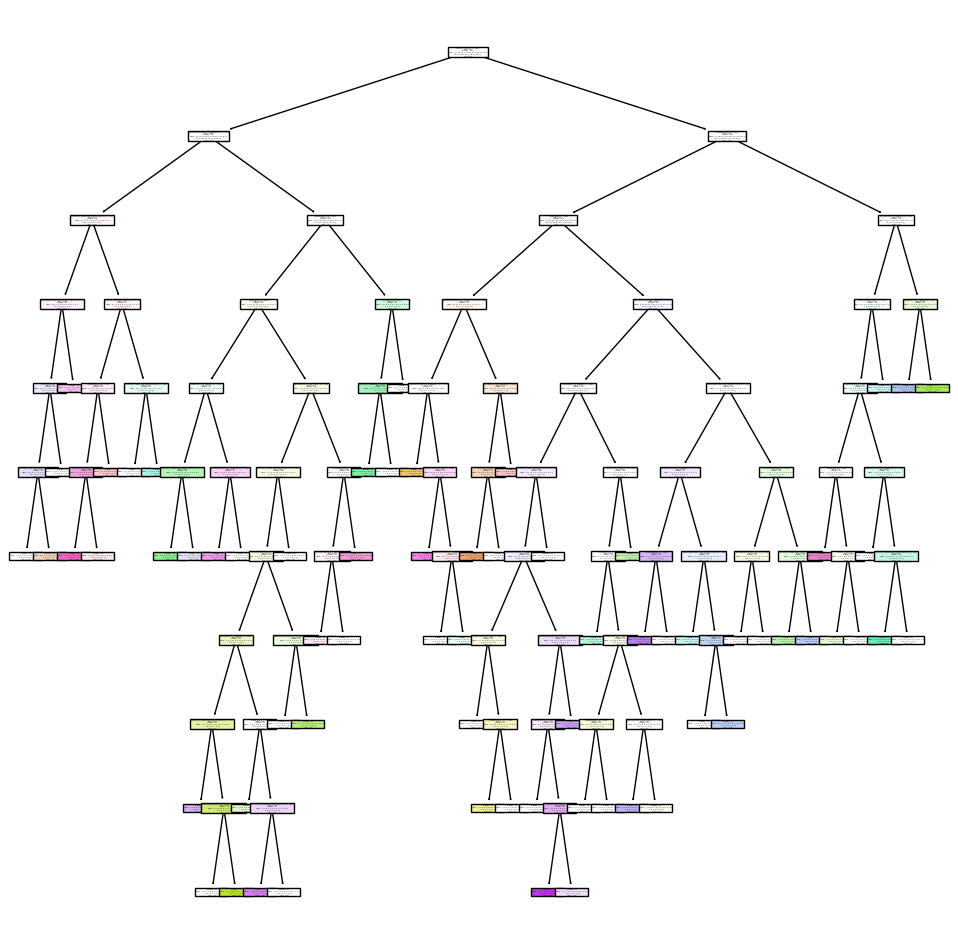

In [ ]:
from sklearn.tree import plot_tree
plt.figure(figsize=(12,12))

plot_tree(tree,
          filled=True,
          feature_names=X.columns,
           class_names=True)
plt.show()
# #plt.savefig()

#Alternative 2: Decision Tree Based on Gini Index

In [ ]:
#!pip install graphviz #improve decision tree diagram
# import graphviz
# from sklearn.tree import DecisionTreeClassifier  #decision tree model
# from sklearn.model_selection import train_test_split # dataset splitter
# from sklearn.preprocessing import StandardScaler
# from sklearn import tree
# #from sklearn.tree import plot_tree
# data=tree.export_graphviz(tree, out_file=None,
#                           feature_names=X.columns,
#                           class_names=True,
#                           filled=True)

# graph=graphviz.Source(tr

In [ ]:
from sklearn.tree import DecisionTreeClassifier  #decision tree model
from sklearn.model_selection import train_test_split # dataset splitter
from sklearn.preprocessing import StandardScaler
from sklearn import tree
from sklearn.tree import plot_tree

features = df2_n.columns.difference(['Age'])

X = df2_n[features]
y = df2_n.Age

# Split the dataset into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Decision Tree with Gini criterion
model_gini = DecisionTreeClassifier(criterion='gini', max_depth=None, random_state=42)
model_gini.fit(X_train, y_train)

# Make predictions on the validation set
y_pred_gini = model_gini.predict(X_valid)
from sklearn.metrics import accuracy_score
scores={}
# Evaluate the model
accuracy_gini = accuracy_score(y_valid, y_pred_gini)
print(f"Decision Tree with Gini Criterion - Accuracy: {accuracy_gini:.2f}")

# Decision Tree with Entropy criterion
# model_entropy = DecisionTreeClassifier(criterion='entropy', max_depth=None, random_state=42)
# model_entropy.fit(X_train, y_train)

# # Make predictions on the validation set
# y_pred_entropy = model_entropy.predict(X_valid)

# # Evaluate the model
# accuracy_entropy = accuracy_score(y_valid, y_pred_entropy)
# print(f"Decision Tree with Entropy Criterion - Accuracy: {accuracy_entropy:.2f}")


Decision Tree with Gini Criterion - Accuracy: 0.96


#Diagram for Decisin Tree based on Gini Index

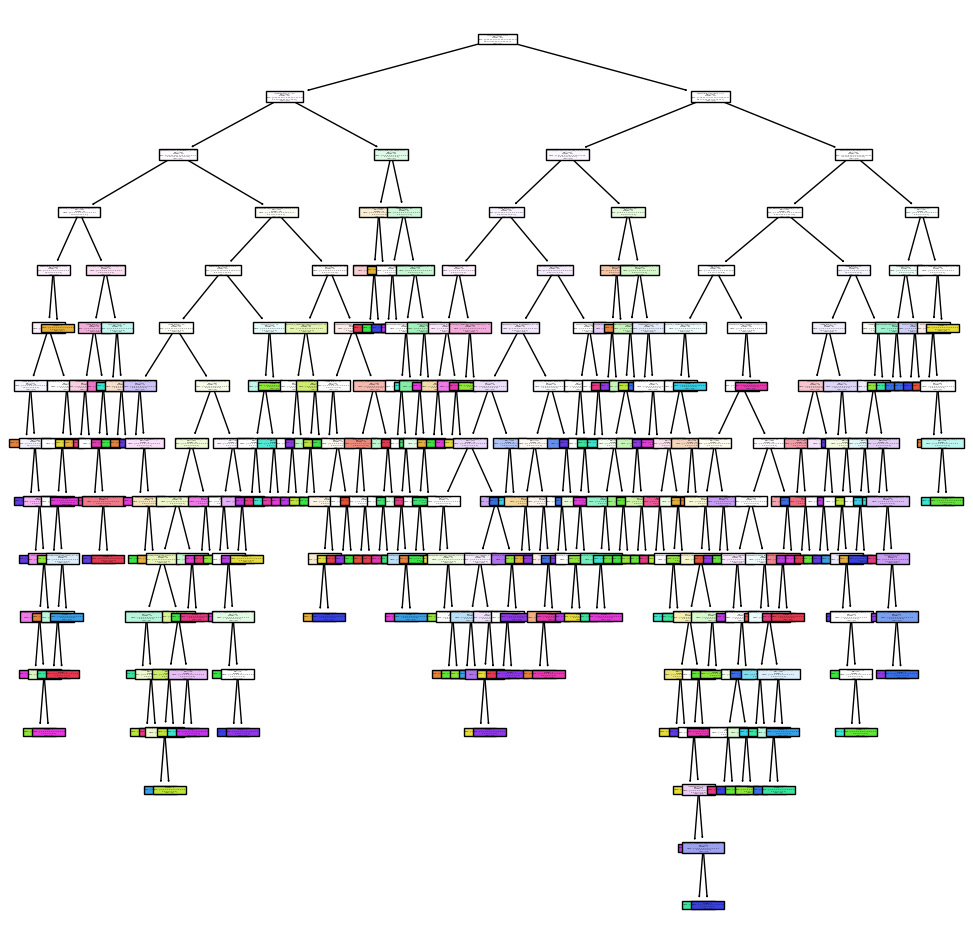

In [ ]:
from sklearn.tree import plot_tree
plt.figure(figsize=(12,12))

plot_tree(model_gini,
          filled=True,
          feature_names=X.columns,
           class_names=True)
plt.show()
# #plt.savefig()

#Decision Tree based on Entropy

In [ ]:
from sklearn.tree import DecisionTreeClassifier  #decision tree model
from sklearn.model_selection import train_test_split # dataset splitter
from sklearn.preprocessing import StandardScaler
from sklearn import tree
from sklearn.tree import plot_tree

features = df2_n.columns.difference(['Age'])

X = df2_n[features]
y = df2_n.Age

# Split the dataset into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.3, random_state=42)

# Decision Tree with Gini criterion
#model_gini = DecisionTreeClassifier(criterion='gini', max_depth=None, random_state=42)
#model_gini.fit(X_train, y_train)

# Make predictions on the validation set
#y_pred_gini = model_gini.predict(X_valid)
from sklearn.metrics import accuracy_score
scores={}
# Evaluate the model
#accuracy_gini = accuracy_score(y_valid, y_pred_gini)
#print(f"Decision Tree with Gini Criterion - Accuracy: {accuracy_gini:.2f}")

# Decision Tree with Entropy criterion
model_entropy = DecisionTreeClassifier(criterion='entropy', max_depth=None, random_state=100, splitter='best')
model_entropy.fit(X_train, y_train)

# # Make predictions on the validation set
y_pred_entropy = model_entropy.predict(X_valid)

# # Evaluate the model
accuracy_entropy = accuracy_score(y_valid, y_pred_entropy)
print(f"Decision Tree with Entropy Criterion - Accuracy: {accuracy_entropy:.2f}")

Decision Tree with Entropy Criterion - Accuracy: 0.96


2nd: 20%-80% Splitting based on entropy

In [ ]:
from sklearn.tree import DecisionTreeClassifier  #decision tree model
from sklearn.model_selection import train_test_split # dataset splitter
from sklearn.preprocessing import StandardScaler
from sklearn import tree
from sklearn.tree import plot_tree

features = df2_n.columns.difference(['Age'])

X = df2_n[features]
y = df2_n.Age

# Split the dataset into training and validation sets
X_train, X_valid, y_train, y_valid = train_test_split(X, y, test_size=0.2, random_state=42)

# Decision Tree with Gini criterion
#model_gini = DecisionTreeClassifier(criterion='gini', max_depth=None, random_state=42)
#model_gini.fit(X_train, y_train)

# Make predictions on the validation set
#y_pred_gini = model_gini.predict(X_valid)
from sklearn.metrics import accuracy_score
scores={}
# Evaluate the model
#accuracy_gini = accuracy_score(y_valid, y_pred_gini)
#print(f"Decision Tree with Gini Criterion - Accuracy: {accuracy_gini:.2f}")

# Decision Tree with Entropy criterion
model_entropy = DecisionTreeClassifier(criterion='entropy', max_depth=None, random_state=100, splitter='best')
model_entropy.fit(X_train, y_train)

# # Make predictions on the validation set
y_pred_entropy = model_entropy.predict(X_valid)

# # Evaluate the model
accuracy_entropy = accuracy_score(y_valid, y_pred_entropy)
print(f"Decision Tree with Entropy Criterion - Accuracy: {accuracy_entropy:.2f}")

Decision Tree with Entropy Criterion - Accuracy: 0.96


#Diagram based on Entropy

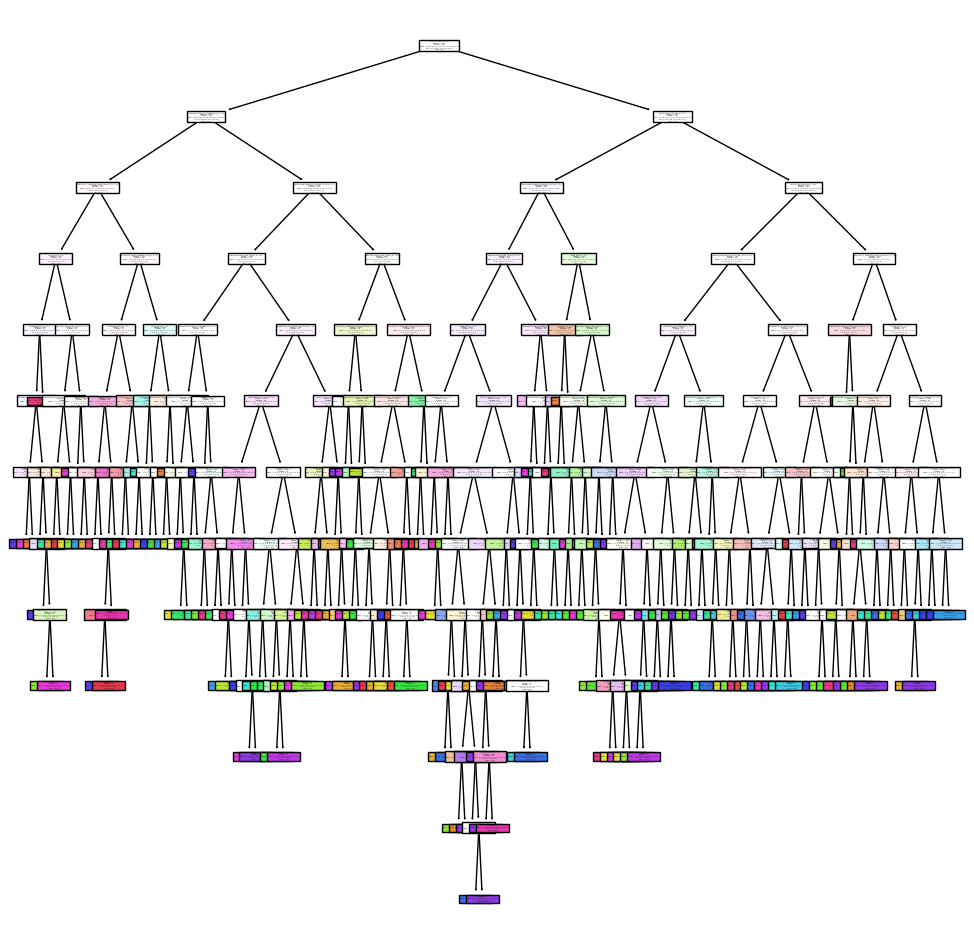

In [ ]:
#from sklearn.tree import plot_tree
plt.figure(figsize=(12,12))

plot_tree(model_entropy,
           filled=True,
           feature_names=X.columns,
          class_names=True)
plt.show()
#plt.savefig()

#Improve on decision tree diagram

In [ ]:
!pip install graphviz #improve decision tree diagram

#Improve Decision tree Entropy_model Diagram

In [ ]:
import graphviz
dataEntropy=tree.export_graphviz(model_entropy, out_file=None,
                          feature_names=X.columns,
                          class_names=True,
                          filled=True)

graph=graphviz.Source(dataEntropy, format='png')
graph
#images_dir = '/content/drive/MyDrive/PROJECT WORK/user_trust_ai'
#plt.savefig(f"{images_dir}/tree_entropymodel1.png")
plt.savefig('/content/drive/MyDrive/PROJECT WORK/user_trust_ai/mtree_entropymodel1.png')

<Figure size 640x480 with 0 Axes>

#Improve Gini Index Diagram Decision Tree

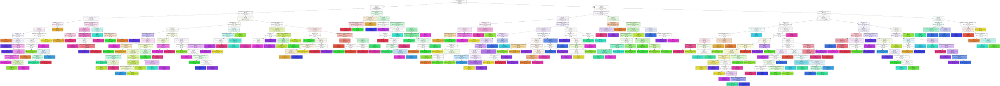

In [ ]:
import graphviz
dataEntropy=tree.export_graphviz(model_gini, out_file=None,
                          feature_names=X.columns,
                          class_names=True,
                          filled=True)

graph=graphviz.Source(dataEntropy, format='png')
graph

In [ ]:
graph.render("decision_tree_graphviz")

'decision_tree_graphviz.png'

In [ ]:
# from dtreeviz.trees import dtreeviz
# vis = dtreeviz.model
# tree=dtreeviz(dataEntropy, X, y,
#               target_name="target",
#               feature_names=X.columns,
#               class_names=True,
#               filled=True)
# tree
# import dtreeviz
# tree = dtreeviz.trees(model_entropy,X_train,y_train,
#            target_name='target',
#            feature_names=X.columns,
#            class_names=True)

# # In a notebook, you can render inline without calling show()
# tree.view(scale=1.4)
# # Uncomment to save with scale 1
# #vizRender = viz.view(scale=1)
# #vizRender.save("play_tennis_decision_tree.svg")

#Confusion Matrix based Gini Index

In [ ]:
# Print the shapes of y_valid and y_pred_gini to verify their sizes
print(f"Shape of y_valid: {y_valid.shape}")
print(f"Shape of y_pred_gini: {y_pred_gini.shape}")

# If the shapes are different, investigate the code that generated these variables
# ... your code to generate y_valid and y_pred_gini ...

# Ensure that both variables are derived from the same dataset split

Shape of y_valid: (204,)
Shape of y_pred_gini: (204,)


In [ ]:
# from sklearn.metrics import confusion_matrix
# conf_matrix=confusion_matrix(y_valid, y_pred_gini)
# conf_matrix
# #plt.figure(figsize=(9,6))

# sns.heatmap(conf_matrix, annot=True)
# plt.xlabel('Predicted label')
# plt.ylabel('True labels')
# plt.title('Confusion matrix Gini Index')
# plt.show()
# #plt.savefig('wine_confusionmatrix.jpg')

#Confusion matrix for Entropy

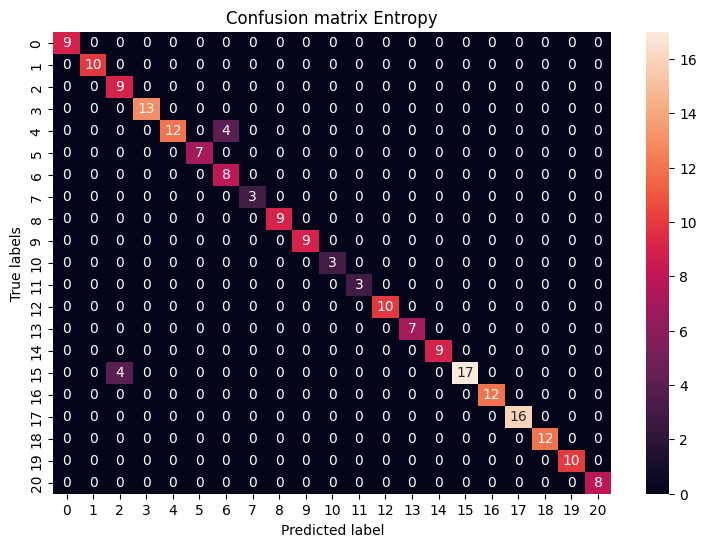

<Figure size 640x480 with 0 Axes>

In [ ]:
from sklearn.metrics import confusion_matrix
conf_matrix= confusion_matrix(y_valid, y_pred_entropy)
conf_matrix
plt.figure(figsize=(9,6))

sns.heatmap(conf_matrix, annot=True)
plt.xlabel('Predicted label')
plt.ylabel('True labels')
plt.title('Confusion matrix Entropy')
plt.show()
plt.savefig('Usertrust_confusionmatrixentropy.jpg')

#SECTION B
#### SEPERATE DATASET INTO DEPENDENT (target) and INDEPENDENT VARIABLE

In [ ]:
df2_n.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 18 columns):
 #   Column                                           Non-Null Count  Dtype
---  ------                                           --------------  -----
 0   Age                                              1020 non-null   int64
 1   Level_of_trust                                   1020 non-null   int64
 2   Clarity_of_Instructions_of_AI                    1020 non-null   int64
 3   Level_of_educati0n_n                             1020 non-null   int64
 4   Income_level_n                                   1020 non-null   int64
 5   Level_of_trust_n                                 1020 non-null   int64
 6   Influencing_factors_n                            1020 non-null   int64
 7   Importance_of_Transparency_and_Explainability_n  1020 non-null   int64
 8   Understanding_AI_by_users_n                      1020 non-null   int64
 9   Transparency_Measures_and_Explanations_n         102

In [ ]:
df2_n[features]


,Clarity_of_Instructions_of_AI,Clarity_of_Instructions_of_AI_n,Concerns_Regarding_Data_Privacy_and_Security_n,Data_Privacy_and_Security_Measures_n,Importance_of_Transparency_and_Explainability_n,Income_level_n,Influencing_factors_n,Integration_with_Existing_Banking_Systems_n,Level_of_educati0n_n,Level_of_trust,Level_of_trust_n,Percieved_Reliability_and_Accuracy_n,Personalization_and_Customization_Options_n,Transparency_Measures_and_Explanations_n,Transparency_of_AI_Algorithms_n,Understanding_AI_by_users_n,User_Education_and_Onboarding_n
0,3,0,0,0,0,0,0,1,0,3,1,0,0,0,0,0,0
1,3,0,0,0,0,0,0,0,1,3,1,0,1,1,1,0,0
2,21,1,1,1,1,2,1,1,1,7,2,1,1,0,1,0,0
3,3,0,0,0,0,0,1,0,1,7,2,1,0,1,0,1,0
4,3,0,0,0,2,1,0,0,0,8,3,1,1,2,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1015,21,1,1,0,0,1,3,0,0,1,0,2,0,1,1,1,0
1016,3,0,1,0,2,1,3,0,1,7,2,2,0,2,0,1,0
1017,3,0,0,0,3,0,2,0,2,7,2,2,0,2,0,0,0
1018,3,0,2,1,2,1,0,1,2,3,1,0,1,2,0,2,1


Declare Train set=X and Test dataset=Y

In [ ]:
target_name = "Age"
y = df2_n[target_name] # y here is the dependent variable
feature_cols = df2_n.columns.difference(['Age'])
x =df2_n[feature_cols]

# features = df2_n.columns.difference(['Age'])

# X = df2_n[features]
# y = df2_n.Age

# features = df2_n.columns.difference(['Age'])
#  x = df2_n[features]
#    y = df2_n.Age

In [ ]:
x.head()

,Clarity_of_Instructions_of_AI,Clarity_of_Instructions_of_AI_n,Concerns_Regarding_Data_Privacy_and_Security_n,Data_Privacy_and_Security_Measures_n,Importance_of_Transparency_and_Explainability_n,Income_level_n,Influencing_factors_n,Integration_with_Existing_Banking_Systems_n,Level_of_educati0n_n,Level_of_trust,Level_of_trust_n,Percieved_Reliability_and_Accuracy_n,Personalization_and_Customization_Options_n,Transparency_Measures_and_Explanations_n,Transparency_of_AI_Algorithms_n,Understanding_AI_by_users_n,User_Education_and_Onboarding_n
0,3,0,0,0,0,0,0,1,0,3,1,0,0,0,0,0,0
1,3,0,0,0,0,0,0,0,1,3,1,0,1,1,1,0,0
2,21,1,1,1,1,2,1,1,1,7,2,1,1,0,1,0,0
3,3,0,0,0,0,0,1,0,1,7,2,1,0,1,0,1,0
4,3,0,0,0,2,1,0,0,0,8,3,1,1,2,0,0,1


#DATA SCALING

In [ ]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
x_res = sc.fit_transform(x)

In [ ]:
x_res

array([[-0.62725005, -0.62725005, -1.13519437, ..., -0.94280904,
        -0.97531389, -0.73221894],
       [-0.62725005, -0.62725005, -1.13519437, ...,  1.06066017,
        -0.97531389, -0.73221894],
       [ 1.59426054,  1.59426054, -0.15058701, ...,  1.06066017,
        -0.97531389, -0.73221894],
       ...,
       [-0.62725005, -0.62725005, -1.13519437, ..., -0.94280904,
        -0.97531389, -0.73221894],
       [-0.62725005, -0.62725005,  0.83402035, ..., -0.94280904,
         1.07164119,  1.36571173],
       [-0.62725005, -0.62725005,  0.83402035, ..., -0.94280904,
         1.07164119,  1.36571173]])

#Variance inflation factor (VIF)
It's a measure of the amount of multicollinearity in regression analysis VIF determines the strength of the correlation between the independent variables.

VIF starts a 1 and has no upper limit
VIF = 1, no correlation between the independent variable and other variables
VIF exceeding 5 or 10 indicates high muticollinearity between this variable and the others italicized text

In [ ]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif = pd.DataFrame()
vif["vif"] = [variance_inflation_factor(x_res,i) for i in range(x_res.shape[1])]
vif['Features'] = x.columns

# Check vif for independent variables
vif

,vif,Features
0,inf,Clarity_of_Instructions_of_AI
1,inf,Clarity_of_Instructions_of_AI_n
2,1.062695,Concerns_Regarding_Data_Privacy_and_Security_n
3,10.157376,Data_Privacy_and_Security_Measures_n
4,1.053850,Importance_of_Transparency_and_Explainability_n
5,1.010956,Income_level_n
6,1.122847,Influencing_factors_n
7,9.918144,Integration_with_Existing_Banking_Systems_n
8,1.079731,Level_of_educati0n_n
9,19.951693,Level_of_trust


In [ ]:
#/usr/local/lib/python3.10/dist-packages/statsmodels/stats/outliers_influence.py:198: RuntimeWarning: divide by zero encountered in double_scalars
#vif = 1. / (1. - r_squared_i)

In [ ]:
y.value_counts()

,count
Age,
22,72
42,72
54,72
21,52
18,52
30,48
47,48
38,48
60,48


#SPLITTING DATA
To understand model performance, dividing the dataset into a training set and validation set is a good strategy.

In [ ]:
#Function for spitting training and test set
from sklearn.model_selection import train_test_split
import numpy as np

#Split x and y into train and test sets
x_train, x_validation, y_train ,y_validation = train_test_split(x_res,y,test_size=0.25, random_state=5)

In [ ]:
x_train.shape, x_validation.shape

((765, 17), (255, 17))

In [ ]:
y_train.unique()

array([32, 54, 25, 42, 60, 67, 18, 28, 38, 24, 19, 77, 55, 47, 37, 30, 22,
       34, 27, 21, 33, 20])

In [ ]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_validation = scaler.fit_transform(x_validation)

#SECTION A
#Decision Tree and Classifier
this decision tree will be base on the 25% / 75% dataset split

For the splitting criterion, we will use Gain Index since this decision tree will be use for classification

In [ ]:
from sklearn.tree import DecisionTreeClassifier

# create decision tree classifier
clf1 = DecisionTreeClassifier(criterion="gini")

# Train Desicion tree classifier
clf1 = clf1.fit(x_train,y_train)

# predict for both x_train, and _validation
# x_train_pred = clf1.predict(x_train)
x_validation_pred = clf1.predict(x_validation)

Accuracy for Gini and 25-75 split:  0.984313725490196
Confusion matrix for Gini and 25-75 split [[ 7  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0 10  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 14  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  6  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 17  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 22  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 15  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0 10  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0 11  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0 14  0  0  0  0  0  0  0  0  0]
 [ 0  0

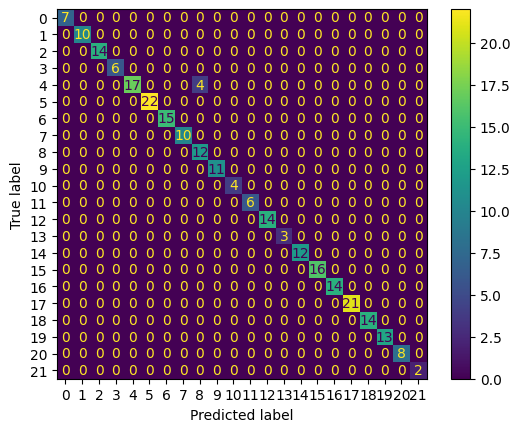

In [ ]:
from sklearn.metrics import confusion_matrix,classification_report,accuracy_score, ConfusionMatrixDisplay
cm1 = confusion_matrix(y_validation, x_validation_pred)
print("Accuracy for Gini and 25-75 split: ", accuracy_score(y_validation, x_validation_pred))
print("Confusion matrix for Gini and 25-75 split", cm1)

cm_display1 = ConfusionMatrixDisplay(cm1).plot()
cm_display1


#Decision Tree Node Visualization for first classifier
This classifier used Gini splitting criterion and 25-75 test-training splitting respectively.

In [ ]:
# Importing needed libraries for tree visualization
from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
import pydotplus

In [ ]:
x_train, x_validation, y_train ,y_validation_gini = train_test_split(x_res,y,test_size=0.20, random_state=5)

scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_validation = scaler.fit_transform(x_validation)

# create decision tree classifier
clf1_gini = DecisionTreeClassifier(criterion="gini")

# Train Desicion tree classifier
clf1_gini = clf1_gini.fit(x_train,y_train)

# predict for both x_train, and _validation
# x_train_pred = clf1.predict(x_train)
x_validation_pred_gini = clf1_gini.predict(x_validation)

#Second Classifier Matrices

Accuracy for Gini and 20-80 split:  1.0
Confusion matrix for Gini and 20-80 split [[ 7  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  6  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 15  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 18  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  8  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0 13  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  

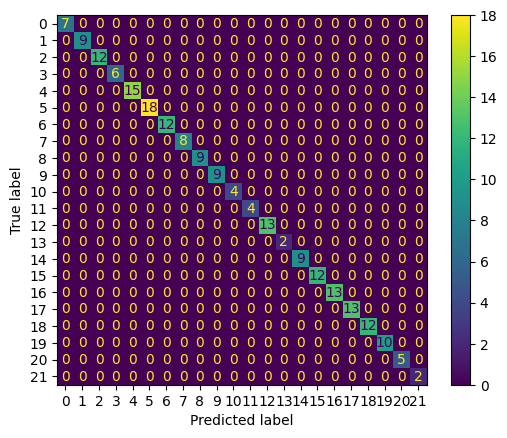

In [ ]:
print("Accuracy for Gini and 20-80 split: ", accuracy_score(y_validation_gini, x_validation_pred_gini))
cm2 = confusion_matrix(y_validation_gini, x_validation_pred_gini)
print("Confusion matrix for Gini and 20-80 split",cm2 )

cm_display2 = ConfusionMatrixDisplay(cm2).plot()
cm_display2

#Third Classifier base on 25-75 splitting using entropy criterio

In [ ]:
x_train, x_validation, y_train ,y_validation = train_test_split(x_res,y,test_size=0.25, random_state=5)

scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_validation = scaler.fit_transform(x_validation)

# create decision tree classifier
clf_entropy_1 = DecisionTreeClassifier(criterion="entropy")

# Train Desicion tree classifier
clf_entropy_1 = clf_entropy_1.fit(x_train,y_train)

# predict for  x_validation
x_validation_pred_entropy = clf_entropy_1.predict(x_validation)

Accuracy for 25% splitting:  0.984313725490196
Confusion matrix for entropy and 25-75 split [[ 7  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  6  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 15  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 18  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  8  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0 13  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 

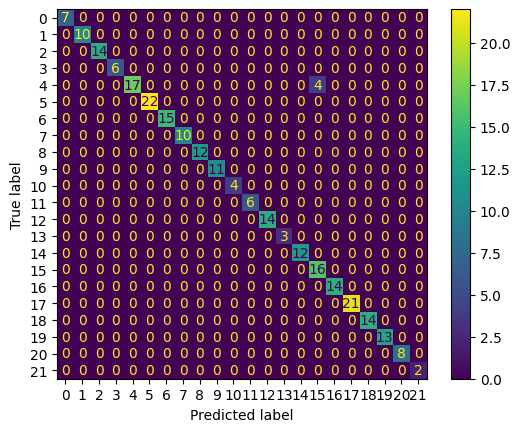

In [ ]:
print("Accuracy for 25% splitting: ", accuracy_score(y_validation, x_validation_pred_entropy))
cm3 = confusion_matrix(y_validation, x_validation_pred_entropy)
print("Confusion matrix for entropy and 25-75 split",cm2 )

cm_display3 = ConfusionMatrixDisplay(cm3).plot()
cm_display3

#Fourth Classifier base on 20-80 splitting using entropy criterion

In [ ]:
x_train, x_validation, y_train ,y_validation_entropy = train_test_split(x_res,y,test_size=0.20, random_state=5)

scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_validation = scaler.fit_transform(x_validation)

# create decision tree classifier
clf_entropy_2 = DecisionTreeClassifier(criterion="entropy")

# Train Desicion tree classifier
clf_entropy_2 = clf_entropy_2.fit(x_train,y_train)

# predict for  x_validation
x_validation_pred_entropy_2 = clf_entropy_2.predict(x_validation)

Accuracy for 20% splitting:  1.0
Confusion matrix for entropy and 20-80 split [[ 7  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  6  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 15  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 18  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  8  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0 13  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0

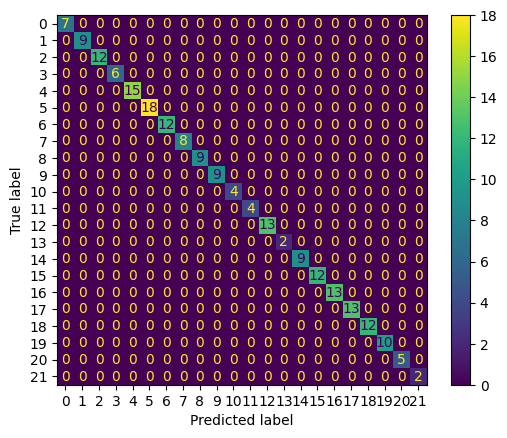

In [ ]:
print("Accuracy for 20% splitting: ", accuracy_score(y_validation_entropy, x_validation_pred_entropy_2))

cm4 = confusion_matrix(y_validation_entropy, x_validation_pred_entropy_2)
print("Confusion matrix for entropy and 20-80 split",cm4 )

cm_display4 = ConfusionMatrixDisplay(cm4).plot()
cm_display4

#Section B
For various splitting criterion and partitions, we can see change in the accuracy of various classification. for gini splitting criterion,

for 30-70 (validation-train) splitting, we recorded 63.44% accuracy
for 20-80 (validation-train) splitting, we recorded 79.03% accuracy
for entropy splitting criterion,

for 30-70 (validation-train) splitting, we recorded 75.26%
for 20-80 (validation-train) splitting, we recorded 79.03%
for 25-75 (validation-train) splitting, we recorded 80.76%

#SECTION C
Observing the confusion matrix for the various classifiers, It can be seen that the 0 (Normal) class is most often confused with the 1 (Hernia) class.

#SECTION D
Analyzing leaf node for 0 (Normal) class and 1 (Hernia) class

In [ ]:
# Nodes for 25-75 partition using gini criterion
dot_data = StringIO()
export_graphviz(clf1_gini, out_file=dot_data, filled=True, rounded=True,
                special_characters=True, feature_names=feature_cols, class_names=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('clf1_tree.png')
Image(graph.create_png())#save fig as picture

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.771987 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.771987 to fit



In [ ]:
# Nodes for 25-75 partition using entropy criterion
dot_data = StringIO()
export_graphviz(clf_entropy_2,out_file=dot_data, filled=True, rounded=True,
                special_characters=True, feature_names=feature_cols, class_names=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('clf3_tree.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.690297 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.690297 to fit



#SECTION E
Understanding the useful features in the classifiers

In [ ]:
def sort_second_val(val):
  return val[1]

# we are comparing the important features for 20-80 split
# for both gini and entropy criterion

values_1 = clf1_gini.feature_importances_ # feature importance for the first classifier
values_2 = clf_entropy_2.feature_importances_ # feature importance for second classifier

features = list(x)

importances = [(features[i], values_1[i]) for i in range(len(features))]
importances.sort(reverse=True, key=sort_second_val)
importances

[('Importance_of_Transparency_and_Explainability_n', 0.11641865902197016),
 ('Income_level_n', 0.10166084973998012),
 ('Understanding_AI_by_users_n', 0.09716051708585334),
 ('Influencing_factors_n', 0.09064532801517067),
 ('Transparency_Measures_and_Explanations_n', 0.0879639101347459),
 ('Concerns_Regarding_Data_Privacy_and_Security_n', 0.07191654653751818),
 ('Percieved_Reliability_and_Accuracy_n', 0.06960463028685027),
 ('Level_of_trust_n', 0.059412457301374434),
 ('Level_of_educati0n_n', 0.05384519596535626),
 ('Transparency_of_AI_Algorithms_n', 0.0438909427779111),
 ('Level_of_trust', 0.0435211415207608),
 ('Personalization_and_Customization_Options_n', 0.043026826187974966),
 ('Data_Privacy_and_Security_Measures_n', 0.032980752331277396),
 ('User_Education_and_Onboarding_n', 0.03090790036136032),
 ('Integration_with_Existing_Banking_Systems_n', 0.020474749373784074),
 ('Clarity_of_Instructions_of_AI_n', 0.01860533522264848),
 ('Clarity_of_Instructions_of_AI', 0.017964258135463533

In [ ]:
importance_1 =  [(features[i], values_2[i]) for i in range(len(features))]
importance_1.sort(reverse=True, key=sort_second_val)
importance_1

[('Income_level_n', 0.11275962334746066),
 ('Influencing_factors_n', 0.11071552596533027),
 ('Transparency_Measures_and_Explanations_n', 0.10098751505389916),
 ('Understanding_AI_by_users_n', 0.08637388621644344),
 ('Percieved_Reliability_and_Accuracy_n', 0.08310929101357054),
 ('Concerns_Regarding_Data_Privacy_and_Security_n', 0.07993340787411644),
 ('Importance_of_Transparency_and_Explainability_n', 0.07946808109845838),
 ('Level_of_educati0n_n', 0.06912778664884511),
 ('User_Education_and_Onboarding_n', 0.04918505456587476),
 ('Transparency_of_AI_Algorithms_n', 0.04667066731592362),
 ('Level_of_trust_n', 0.04656328101722415),
 ('Clarity_of_Instructions_of_AI', 0.04003455522568824),
 ('Integration_with_Existing_Banking_Systems_n', 0.023956529562773676),
 ('Data_Privacy_and_Security_Measures_n', 0.023772309356780832),
 ('Level_of_trust', 0.02363077519035169),
 ('Clarity_of_Instructions_of_AI_n', 0.012966785331664754),
 ('Personalization_and_Customization_Options_n', 0.0107449252155944

From analyzing the important features for both classifiers, We can see that some features are not "so important" to the performance of the classifier.

Hence in this section, we will drop of these features and retry and classifiers base on same performing partition (20-80) and compare performance.

We will drop Personalization_and_Customization_Options_n, and Importance_of_Transparency_and_Explainability_n

In [ ]:
df2_n.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 18 columns):
 #   Column                                           Non-Null Count  Dtype
---  ------                                           --------------  -----
 0   Age                                              1020 non-null   int64
 1   Level_of_trust                                   1020 non-null   int64
 2   Clarity_of_Instructions_of_AI                    1020 non-null   int64
 3   Level_of_educati0n_n                             1020 non-null   int64
 4   Income_level_n                                   1020 non-null   int64
 5   Level_of_trust_n                                 1020 non-null   int64
 6   Influencing_factors_n                            1020 non-null   int64
 7   Importance_of_Transparency_and_Explainability_n  1020 non-null   int64
 8   Understanding_AI_by_users_n                      1020 non-null   int64
 9   Transparency_Measures_and_Explanations_n         102

In [ ]:
#df2_n.columns.difference(['Age'])

Note: Do not drop any feature

In [ ]:
target_name = "Age"
y = df2_n[target_name] # y here is the dependent variable
feature_cols =df2_n.columns.difference(['Age'])
#feature_cols = ['Importance_of_Transparency_and_Explainability_n' , 'Personalization_and_Customization_Options_n']
x = df2_n[feature_cols]

In [ ]:
# A classifier for gini index splitting criterion

x_train, x_validation, y_train ,y_validation = train_test_split(x,y,test_size=0.25, random_state=5)

scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_validation = scaler.fit_transform(x_validation)

# create decision tree classifier
new_clf1 = DecisionTreeClassifier(criterion="gini")

# Train Desicion tree classifier
new_clf1 = new_clf1.fit(x_train,y_train)

# predict for  x_validation
x_val_new_clf1 = new_clf1.predict(x_validation)

Accuracy for 20% splitting:  0.984313725490196
Confusion matrix for entropy and 20-80 split [[ 7  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0 10  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 14  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  6  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 17  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 22  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 15  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0 10  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0 11  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  6  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0 14  0  0  0  0  0  0  0  0  0]
 [ 0  0  0 

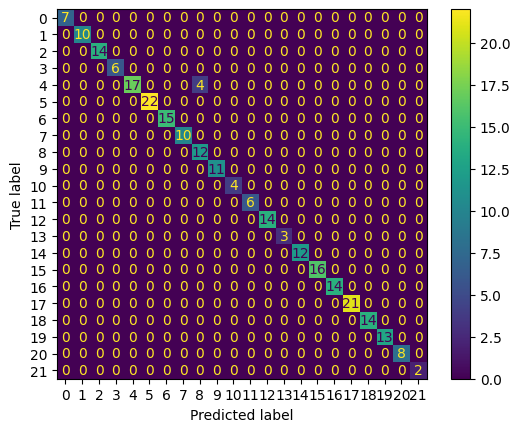

In [ ]:
print("Accuracy for 20% splitting: ", accuracy_score(y_validation, x_val_new_clf1))

cm5 = confusion_matrix(y_validation, x_val_new_clf1)
print("Confusion matrix for entropy and 20-80 split",cm5 )

cm_display5 = ConfusionMatrixDisplay(cm5).plot()
cm_display5

In [ ]:
dot_data = StringIO()
export_graphviz(new_clf1,out_file=dot_data, filled=True, rounded=True,
                special_characters=True, feature_names=feature_cols, class_names=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('clf5_tree.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.788275 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.788275 to fit



#Next decision tree using Entropy criterion

In [ ]:
# A classifier for gini index splitting criterion

x_train, x_validation, y_train ,y_validation = train_test_split(x,y,test_size=0.20, random_state=5)

scaler = StandardScaler()
x_train = scaler.fit_transform(x_train)
x_validation = scaler.fit_transform(x_validation)

# create decision tree classifier
new_clf2 = DecisionTreeClassifier(criterion="entropy")

# Train Desicion tree classifier
new_clf2 = new_clf2.fit(x_train,y_train)

# predict for  x_validation
x_val_new_clf2 = new_clf2.predict(x_validation)

Accuracy for 20% splitting:  1.0
Confusion matrix for entropy and 20-80 split [[ 7  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  9  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  6  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0 15  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0 18  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0 12  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  8  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  4  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0 13  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  0

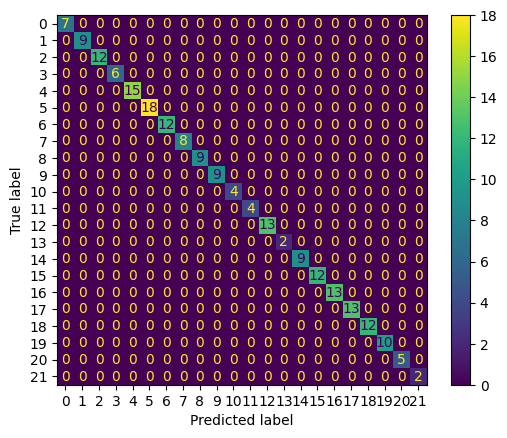

In [ ]:
print("Accuracy for 20% splitting: ", accuracy_score(y_validation, x_val_new_clf2))
cm6 = confusion_matrix(y_validation, x_val_new_clf2)
print("Confusion matrix for entropy and 20-80 split",cm6 )

cm_display6 = ConfusionMatrixDisplay(cm6).plot()
cm_display6

In [ ]:
dot_data = StringIO()
export_graphviz(new_clf1,out_file=dot_data, filled=True, rounded=True,
                special_characters=True, feature_names=feature_cols, class_names=True)

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())
graph.write_png('clf5_tree.png')
Image(graph.create_png())

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.788275 to fit

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.788275 to fit



#Comparing the classification report for the different pairs of classifier that used same splitting criterion.
Classifiers compared use same splitting partition (20-80)

In [ ]:
print("Classification report `gini` criterion")
print("Accuracy all independent classifier ", accuracy_score(y_validation_gini, x_validation_pred_gini))
print("for all independent variables \n", classification_report(y_validation_gini, x_validation_pred_gini,digits=4));
print("----------------------------")
print("for selected dependent variables \n", classification_report(y_validation, x_val_new_clf1,digits=4))
print("Accuracy selected independent classifier ", accuracy_score(y_validation, x_val_new_clf1))

Classification report `gini` criterion
Accuracy all independent classifier  1.0
for all independent variables 
               precision    recall  f1-score   support

          18     1.0000    1.0000    1.0000         7
          19     1.0000    1.0000    1.0000         9
          20     1.0000    1.0000    1.0000        12
          21     1.0000    1.0000    1.0000         6
          22     1.0000    1.0000    1.0000        15
          24     1.0000    1.0000    1.0000        18
          25     1.0000    1.0000    1.0000        12
          27     1.0000    1.0000    1.0000         8
          28     1.0000    1.0000    1.0000         9
          30     1.0000    1.0000    1.0000         9
          32     1.0000    1.0000    1.0000         4
          33     1.0000    1.0000    1.0000         4
          34     1.0000    1.0000    1.0000        13
          37     1.0000    1.0000    1.0000         2
          38     1.0000    1.0000    1.0000         9
          42     1.0000

ValueError: Found input variables with inconsistent numbers of samples: [204, 255]

#First classifier Comparison
We can see from above comparison that:

There isn't a change in the accuracy after droping some of the features

The precision for class 0 in the second classifier has increased (0.7600) compared to (0.7407) seen in the original classifier.

The new classifier (NC) has lower precision score for 1 class

Both classifiers has same precision score for 2 class

The Original classifier (OC) has a little higher macro average recall score compared to that of the new classifier, but both has same weighted average recall score

The macro average f1-score is a little higher in the original classifier compared to the new classifier

In [ ]:
print("Classification report `entropy` criterion")
print("Accuracy all independent classifier ", accuracy_score(y_validation_entropy, x_validation_pred_entropy_2))
print("for all independent variables \n", classification_report(y_validation_entropy, x_validation_pred_entropy_2,digits=4));
print("----------------------------")
print("for selected dependent variables \n", classification_report(y_validation, x_val_new_clf2,digits=4))
print("Accuracy selected independent classifier ", accuracy_score(y_validation, x_val_new_clf2))

Classification report `entropy` criterion
Accuracy all independent classifier  1.0
for all independent variables 
               precision    recall  f1-score   support

          18     1.0000    1.0000    1.0000         7
          19     1.0000    1.0000    1.0000         9
          20     1.0000    1.0000    1.0000        12
          21     1.0000    1.0000    1.0000         6
          22     1.0000    1.0000    1.0000        15
          24     1.0000    1.0000    1.0000        18
          25     1.0000    1.0000    1.0000        12
          27     1.0000    1.0000    1.0000         8
          28     1.0000    1.0000    1.0000         9
          30     1.0000    1.0000    1.0000         9
          32     1.0000    1.0000    1.0000         4
          33     1.0000    1.0000    1.0000         4
          34     1.0000    1.0000    1.0000        13
          37     1.0000    1.0000    1.0000         2
          38     1.0000    1.0000    1.0000         9
          42     1.0

#Second classifier Comparison
We can see from above comparison that:

There isn't a change in the accuracy after droping some of the features

Both the macro average and weighted average precision score are same for both classifiers. (Old and New)

Dropping some attributes didn't have much change to the performance of the classifiers

In [ ]:
#import sklearn.datasets
#import pandas as pd
#import numpy as np
#from sklearn.model_selection import train_test_split
#from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
#import sklearn
#from sklearn.ensemble import RandomForestClassifier

#Create a Gaussian Classifier
#rfc=RandomForestClassifier(n_estimators=5, max_depth=3)
#iris_sklearn_ds=df2_n
#X_ndarray = iris_sklearn_ds.data
#y_ndarray = iris_sklearn_ds.target.astype(np.int32)
#X_ndarray_train,X_ndarray_test,y_ndarray_train,y_ndarray_test = train_test_split(X_ndarray,
 #                                                y_ndarray,
 #                                                test_size=0.30,
 #                                                random_state=42)

#Train the model using the training sets y_pred=clf.predict(X_test)
#rfc.fit(X_ndarray_train,y_ndarray_train)
#y_pred=rfc.predict(X_ndarray_test)
#print("Accuracy RFC:",metrics.accuracy_score(y_ndarray_test, y_pred))
#print(metrics.confusion_matrix(y_ndarray_test, y_pred))


#Random forest prediction on the dataset

In [ ]:
import sklearn.datasets
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn import metrics # Import scikit-learn metrics module for accuracy calculation
from sklearn.ensemble import RandomForestClassifier


target_name = "Age"
y_ndarray = df2_n[target_name] # y here is the dependent variable
feature_cols = df2_n.columns.difference(['Age'])
X_ndarray =df2_n[feature_cols]

# Load the Iris dataset
# iris_sklearn_ds = sklearn.datasets.load_iris()
# X_ndarray = iris_sklearn_ds.data
# y_ndarray = iris_sklearn_ds.target.astype(np.int32)

# Split the dataset into training and testing sets
X_ndarray_train, X_ndarray_test, y_ndarray_train, y_ndarray_test = train_test_split(
    X_ndarray, y_ndarray, test_size=0.20, random_state=42)

# Create a RandomForestClassifier
rfc = RandomForestClassifier(n_estimators=5, max_depth=3)

# Train the model using the training sets
rfc.fit(X_ndarray_train, y_ndarray_train)

# Predict the responses for the test dataset
y_pred = rfc.predict(X_ndarray_test)

# Evaluate the accuracy and print the confusion matrix
print("Accuracy RFC:", metrics.accuracy_score(y_ndarray_test, y_pred))
print(metrics.confusion_matrix(y_ndarray_test, y_pred))


Accuracy RFC: 0.22058823529411764
[[3 0 0 2 1 0 0 1 0 0 0 0 1 0 0 0 0 1 0 0 0 0]
 [0 2 3 0 1 0 0 0 1 0 0 0 0 0 1 0 0 2 0 0 0 0]
 [0 0 5 0 0 0 0 0 0 0 0 0 0 0 0 3 0 1 0 0 0 0]
 [0 0 2 4 0 0 0 0 0 0 0 0 0 0 1 1 0 0 0 0 5 0]
 [0 0 2 0 5 0 0 0 0 1 0 0 0 0 0 2 0 6 0 0 0 0]
 [0 0 0 0 1 0 0 0 0 2 0 0 0 0 1 2 0 0 0 0 1 0]
 [0 0 0 1 2 0 1 1 0 0 0 0 0 0 0 0 0 3 0 0 0 0]
 [0 0 0 0 0 0 0 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 1 0 1 4 0 0 0 0 0 0 2 0 0 0 0 1 0 0 0 0]
 [1 0 1 0 0 0 0 0 0 5 0 0 0 0 0 2 0 0 0 0 0 0]
 [0 0 0 0 1 0 0 0 0 0 0 0 2 0 0 0 0 0 0 0 0 0]
 [0 0 0 0 1 0 0 1 0 0 0 0 0 0 0 0 0 1 0 0 0 0]
 [0 0 0 0 5 0 0 0 0 0 0 0 3 0 1 1 0 0 0 0 0 0]
 [0 0 2 1 0 2 0 1 0 1 0 0 0 0 0 0 0 0 0 0 0 0]
 [0 0 2 0 1 0 0 0 0 0 0 0 0 0 0 1 0 5 0 0 0 0]
 [0 0 3 2 2 0 0 0 2 1 0 0 0 0 3 7 0 1 0 0 0 0]
 [0 0 2 2 0 0 0 1 0 3 0 0 0 0 0 4 0 0 0 0 0 0]
 [0 0 2 1 3 0 0 0 0 0 0 0 0 0 0 0 0 5 0 0 3 2]
 [0 0 3 3 1 0 0 0 0 1 0 0 0 0 0 2 0 1 1 0 0 0]
 [1 0 2 0 1 0 0 0 2 1 0 0 0 0 1 0 0 2 0 0 0 0]
 [0 0 1 4 0 0 0 0 0 0 0 0 

#SVM  Support Vector Machine with Age

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.datasets import load_iris

# Load the Iris dataset
# iris = load_iris()
# X = iris.data
# y = iris.target

target_name = "Age"
y = df2_n[target_name] # y here is the dependent variable
feature_cols = df2_n.columns.difference(['Age'])
X =df2_n[feature_cols]

# Split the dayaset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Create a SVM Classifier
svm_model = SVC(kernel='linear')  # You can also try 'poly', 'rbf', 'sigmoid'

# Train the model using the training sets
svm_model.fit(X_train, y_train)

# Predict the response for the test dataset
y_pred = svm_model.predict(X_test)

# Evaluate the accuracy and print the confusion matrix
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
print("Confusion Matrix:\n", metrics.confusion_matrix(y_test, y_pred))
print("Classification Report:\n", metrics.classification_report(y_test, y_pred))


Accuracy: 0.4542483660130719
Confusion Matrix:
 [[ 8  2  0  0  0  2  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  8  3  3  0  0  0  0  0  0  1  0  1  0  0  0  0  0  0  0  0  0]
 [ 2  1  7  0  0  0  2  0  0  0  0  0  0  0  0  3  0  0  0  0  0  0]
 [ 0  0  0 12  0  0  0  0  0  0  0  0  0  0  1  0  0  1  3  0  0  0]
 [ 0  2  0  4  8  0  0  0  0  0  0  0  5  3  0  3  0  1  1  0  1  0]
 [ 0  0  1  0  0  8  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  2  2  0  4  2  0  0  0  2  0  0  1  0  2  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  7  0  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  2  1  0  0  6  0  0  0  0  0  0  1  3  1  0  0  0  0]
 [ 0  2  0  0  0  1  0  0  0  8  0  0  2  0  0  0  1  0  0  0  0  0]
 [ 0  2  0  0  0  0  0  0  0  0  2  0  0  0  0  0  0  0  0  0  0  0]
 [ 0  2  0  0  0  0  0  0  0  0  0  2  0  0  0  0  0  2  0  0  0  0]
 [ 0  0  0  0  3  2  0  0  0  0  0  0  6  0  0  0  0  0  1  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  0  5  0  0  0  2

In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = {'C': [0.1, 1, 10, 100], 'gamma': ['scale', 'auto'], 'kernel': ['linear', 'rbf']}
grid = GridSearchCV(SVC(), param_grid, refit=True, verbose=2)
grid.fit(X_train, y_train)

print("Best Parameters:", grid.best_params_)
print("Best Estimator:", grid.best_estimator_)

# Predict using the best estimator
grid_predictions = grid.predict(X_test)
print("Accuracy:", metrics.accuracy_score(y_test, grid_predictions))
print("Confusion Matrix:\n", metrics.confusion_matrix(y_test, grid_predictions))
print("Classification Report:\n", metrics.classification_report(y_test, grid_predictions))

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.0s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.1s
[CV] END ...................C=0.1, gamma=auto, kernel=linear; total time=   0.0s
[CV] END ...................C=0.1, gamma=auto, k

#SVM with Test split: Level of eductatin

In [ ]:
df2_n.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1020 entries, 0 to 1019
Data columns (total 18 columns):
 #   Column                                           Non-Null Count  Dtype
---  ------                                           --------------  -----
 0   Age                                              1020 non-null   int64
 1   Level_of_trust                                   1020 non-null   int64
 2   Clarity_of_Instructions_of_AI                    1020 non-null   int64
 3   Level_of_educati0n_n                             1020 non-null   int64
 4   Income_level_n                                   1020 non-null   int64
 5   Level_of_trust_n                                 1020 non-null   int64
 6   Influencing_factors_n                            1020 non-null   int64
 7   Importance_of_Transparency_and_Explainability_n  1020 non-null   int64
 8   Understanding_AI_by_users_n                      1020 non-null   int64
 9   Transparency_Measures_and_Explanations_n         102

In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn import metrics
from sklearn.datasets import load_iris

# Load the Iris dataset
# iris = load_iris()
# X = iris.data
# y = iris.target

target_name = "Level_of_educati0n_n"
y = df2_n[target_name] # y here is the dependent variable
feature_cols = df2_n.columns.difference(['Level_of_educati0n_n'])
X =df2_n[feature_cols]

# Split the dayaset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Create a SVM Classifier
svm_model = SVC(kernel='linear')  # You can also try 'poly', 'rbf', 'sigmoid'

# Train the model using the training sets
svm_model.fit(X_train, y_train)

# Predict the response for the test dataset
y_pred = svm_model.predict(X_test)

# Evaluate the accuracy and print the confusion matrix
print("Accuracy:", metrics.accuracy_score(y_test, y_pred))
print("Confusion Matrix:\n", metrics.confusion_matrix(y_test, y_pred))
print("Classification Report:\n", metrics.classification_report(y_test, y_pred))


Accuracy: 0.5359477124183006
Confusion Matrix:
 [[75 41 14]
 [32 55 12]
 [20 23 34]]
Classification Report:
               precision    recall  f1-score   support

           0       0.59      0.58      0.58       130
           1       0.46      0.56      0.50        99
           2       0.57      0.44      0.50        77

    accuracy                           0.54       306
   macro avg       0.54      0.52      0.53       306
weighted avg       0.54      0.54      0.54       306



In [ ]:
from sklearn.model_selection import GridSearchCV

param_grid = {'C': [0.1, 1, 10, 100], 'gamma': ['scale', 'auto'], 'kernel': ['linear', 'rbf']}
grid = GridSearchCV(SVC(), param_grid, refit=True, verbose=2)
grid.fit(X_train, y_train)

print("Best Parameters:", grid.best_params_)
print("Best Estimator:", grid.best_estimator_)

# Predict using the best estimator
grid_predictions = grid.predict(X_test)
print("Accuracy:", metrics.accuracy_score(y_test, grid_predictions))
print("Confusion Matrix:\n", metrics.confusion_matrix(y_test, grid_predictions))
print("Classification Report:\n", metrics.classification_report(y_test, grid_predictions))

Fitting 5 folds for each of 16 candidates, totalling 80 fits
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.2s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.2s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.2s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.2s
[CV] END ..................C=0.1, gamma=scale, kernel=linear; total time=   0.1s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.1s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.1s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.2s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.1s
[CV] END .....................C=0.1, gamma=scale, kernel=rbf; total time=   0.1s
[CV] END ...................C=0.1, gamma=auto, kernel=linear; total time=   0.2s
[CV] END ...................C=0.1, gamma=auto, k